## Zadanie 1

In [11]:
bitstring(Float16(1)/Float16(3))

"0011010101010101"

In [12]:
bitstring(Float32(1)/Float32(3))

"00111110101010101010101010101011"

In [14]:
bitstring(Float64(1)/Float64(3))

"0011111111010101010101010101010101010101010101010101010101010101"

In [15]:
f16 = Float16(1) / Float16(3)
f64_from_f16 = Float64(f16)
bitstring(f64_from_f16)


"0011111111010101010101000000000000000000000000000000000000000000"

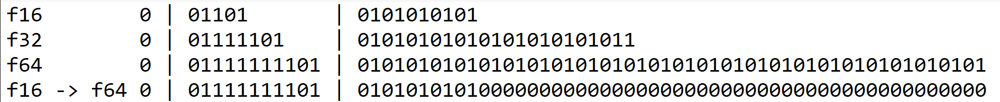

#### Porównanie reprezentacji bitowej 1/3 w Float16, Float32 i Float64

| Typ         | Znak (S) | Wykładnik (E, bin) | Wykładnik (E, dec) | Cecha (E - bias) | Mantysa (M, bin)            | Mantysa (M, dec)       | Wartość w IEEE 754 |
|------------|----------|--------------------|--------------------|------------------|----------------------------|------------------------|--------------------|
| Float16    | 0        | 01101            | 13        | -2         | 1.0101010101             | 1.3330078125           | 0.333251953125  |
| Float32    | 0        | 01111101            | 125        | -2        | 1.01010101010101010101011  | 1.33333337306976318359375           | 0.3333333432674407958984375  |
| Float64    | 0        | 01111111101            | 1021        | -2       | 1.0101010101010101010101010101010101010101010101010101 | 1.3333333333333332593184650249895639717578887939453125 | 0.333333333333333314829616256247390992939472198486328125 |
| Float16 → Float64 | 0 | 01111111101            | 1021        | -2       | 1.0101010101000000000000000000000000000000000000000000 | 1.3330078125 | 0.333251953125  |

## Zadanie 2

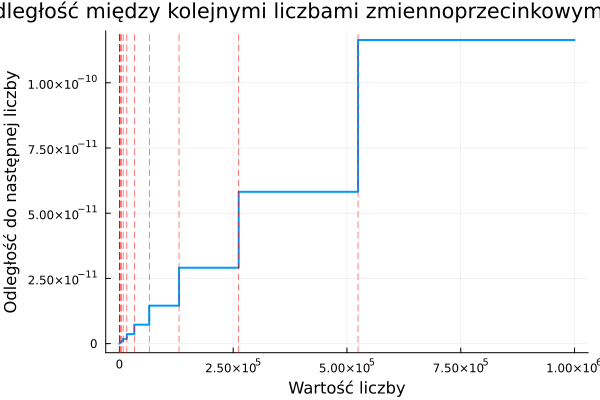

In [13]:
using Plots
gr()

values = 1.0:1.0:1000000.0

gaps = [nextfloat(x) - x for x in values]

# plot(values,xscale=:log10, yscale=:log10, gaps,  xlabel="Wartość liczby", ylabel="Odległość do następnej liczby", 
    #  title="Odległość między kolejnymi liczbami zmiennoprzecinkowymi w Float64", lw=2, legend=false)

plot(values, gaps,  xlabel="Wartość liczby", ylabel="Odległość do następnej liczby", 
     title="Odległość między kolejnymi liczbami zmiennoprzecinkowymi w Float64", lw=2, legend=false)

powers_of_2 = [2.0^n for n in 0:floor(Int, log2(1_000_000))]

for p in powers_of_2
    vline!([p], color=:red, linestyle=:dash, lw=0.5, label=false)
end

display(plot!())

## Zadanie 3

Kod w C

```c
#include <stdio.h>
#include <gsl/gsl_ieee_utils.h>

int main() {

    printf("Analiza reprezentacji IEEE 754 dla malejących liczb zmiennoprzecinkowych:\n");

    for (int i = 0; i < 100; i++) {
        printf("\nx = %e\n", x);

        printf("Reprezentacja IEEE 754: ");

        gsl_ieee_printf_double(&x);
        
        x /= 2.0; // Zmniejszamy liczbę o połowę
    }
    
    return 0;
}


Moment zdenormalizowania

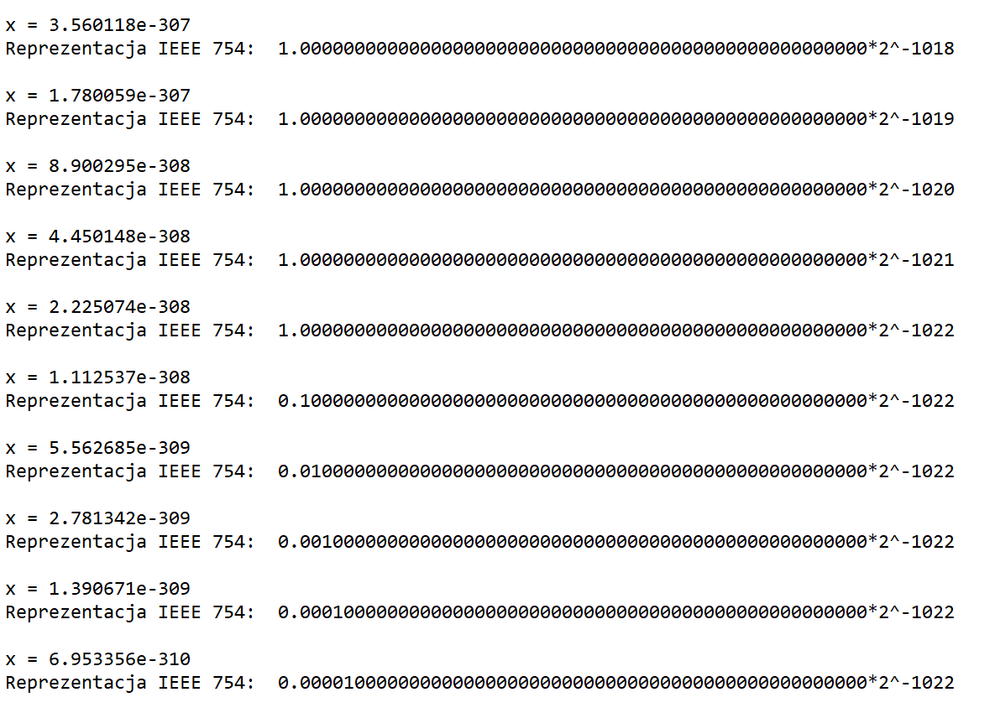

## Zadanie 4

Suma szeregu harmonicznego

In [ ]:
using Printf

function harmonic_sum_forward(n)
    sum = 0.0
    for i in 1:n
        sum += 1.0 / i
    end
    return sum
end

function harmonic_sum_backward(n)
    sum = 0.0
    for i in n:-1:1
        sum += 1.0 / i
    end
    return sum
end

N = 10^6

sum_forward = harmonic_sum_forward(N)
sum_backward = harmonic_sum_backward(N)

@printf "Suma szeregu harmonicznego (od 1 do %d): %.15f\n" N sum_forward
@printf "Suma szeregu harmonicznego (od %d do 1): %.15f\n" N sum_backward
@printf "Różnica między wynikami: %.15e\n" abs(sum_forward - sum_backward)

Suma szeregu harmonicznego (od 1 do 1000000): 14.392726722864989
Suma szeregu harmonicznego (od 1000000 do 1): 14.392726722865772
Różnica między wynikami: 7.833733661755105e-13


Hm... ale z czego to wynika ?? 🤔

In [ ]:
using Printf

function check_stability(n)
    sum = Float16(1.0)
    threshold_index = 0
    
    for i in 2:n
        
        prev_sum = sum
        sum += Float16(1.0) / Float16(i)
        # println(sum - prev_sum)
        
        if sum == prev_sum
            threshold_index = i
            break
        end
    end
    
    return threshold_index
end


function show_mantissa(n)
    first_term = Float16(1.0)
    last_term = Float16(1.0) / Float16(n)
    common_exponent = exponent(first_term)
    
    mantissa_first = first_term / Float16(2.0)^common_exponent
    mantissa_last = last_term / Float16(2.0)^common_exponent
    
    bit_first = bitstring(first_term)
    bit_last = bitstring(last_term)
    
    @printf "Pierwszy wyraz (binarnie): %s\n" bit_first
    @printf "Ostatni wyraz (binarnie):  %s\n" bit_last
end


N = 10^4

threshold = check_stability(N)
@printf "Od wyrazu %d wynik sumowania przestaje się zmieniać.\n" threshold

show_mantissa(N)

Od wyrazu 513 wynik sumowania przestaje się zmieniać.
Pierwszy wyraz (binarnie): 0011110000000000
Ostatni wyraz (binarnie):  0000011010001110


-> Wystarczy że dla systemu szesnastkowego różnica cech będzie rzędu 2^10 to wstarcza by wyzerować mantyse. Jeżeli sumujemy od 1 to jak najbardziej się tak dzieje natomiast jezeli sumujemy od końca to do tego nie dochodzi.